In [ ]:
!pip install cupy-cuda100

     |████████████████████████████████| 58.9 MB 5.9 MB/s 


In [1]:
from IPython.display import Image as Img
import matplotlib.pyplot as plt
from timeit import default_timer
from tqdm import tqdm
from PIL import Image
import numpy as np
import cupy as cp
import glob
import os

## [High performance with <u><i><strong>CUDA</strong></i></u>](https://cupy.chainer.org/)
<u><i><strong>CuPy</strong></i></u> is an open-source matrix library accelerated with <u><i><strong>NVIDIA CUDA</strong></i></u>. <u><i><strong>CuPy</strong></i></u> provides GPU accelerated computing with Python. CuPy uses CUDA-related libraries including <u><i><strong>cuBLAS</strong></i></u>, <u><i><strong>cuDNN</strong></i></u>, <u><i><strong>cuRand</strong></i></u>, <u><i><strong>cuSolver</strong></i></u>, <u><i><strong>cuSPARSE</strong></i></u>, <u><i><strong>cuFFT</strong></i></u> and <u><i><strong>NCCL</strong></i></u> to make full use of the <u><i><strong>GPU</strong></i></u> architecture.
The figure shows <u><i><strong>CuPy</strong></i></u> speedup over NumPy. Most of them perform well on a <u><i><strong>GPU</strong></i></u> using CuPy out of the box. <u><i><strong>CuPy</strong></i></u> speeds up some operations more than 100X. You can read original benchmark article in [Single-<u><i><strong>GPU</strong></i></u> <u><i><strong>CuPy</strong></i></u> Speedups (RAPIDS AI)](https://medium.com/rapids-ai/single-gpu-cupy-speedups-ea99cbbb0cbb).


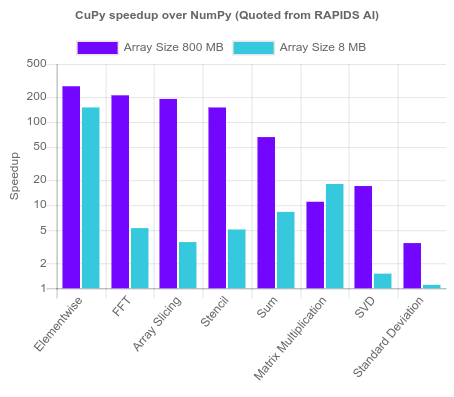

## [Highly compatible with <u><i><strong>NumPy</strong></i></u>](https://cupy.chainer.org/)
<u><i><strong>CuPy</strong></i></u>'s interface is highly compatible with <u><i><strong>NumPy</strong></i></u>; in most cases it can be used as a <strong><i><u>drop-in replacement</u></i></strong>. <i><u>All you need to do</u></i> is just <strong><i><u>replace numpy with cupy</u></i></strong> in your Python code. [Basics of <u><i><strong>CuPy</strong></i></u> (Tutorial)](https://docs-cupy.chainer.org/en/stable/tutorial/basic.html) is usefull to learn first step of <u><i><strong>CuPy</strong></i></u>.
<u><i><strong>CuPy</strong></i></u> supports various methods, indexing, data types, broadcasting and more. [Comparison Table (Reference Manual)](https://docs-cupy.chainer.org/en/stable/reference/comparison.html) shows a list of NumPy / <u><i><strong>SciPy</strong></i></u> APIs and its corresponding <u><i><strong>CuPy</strong></i></u> implementations.

In [ ]:
# x = cp.arange(6).reshape(2, 3).astype('f')
# print("x =\n", x)

# sum_result = x.sum(axis=1)
# print("\nsum = ", sum_result)

## [Easy to write a custom kernel](https://cupy.chainer.org/)
You can easily make a custom <u><i><strong>CUDA</strong></i></u> kernel if you want to make your code run faster, requiring only a small code snippet of <u><i><strong>C++</strong></i></u>. <u><i><strong>CuPy</strong></i></u> automatically wraps and compiles it to make a <u><i><strong>CUDA</strong></i></u> binary. Compiled binaries are cached and reused in subsequent runs. Please read [User-Defined Kernels (Tutorial)](https://docs-cupy.chainer.org/en/latest/tutorial/kernel.html).
And, you can also use raw <u><i><strong>CUDA</strong></i></u> kernel via [Raw modules (Tutorial)](https://docs-cupy.chainer.org/en/latest/tutorial/kernel.html#raw-modules).


In [ ]:
# x=cp.arange(6, dtype='f').reshape(2, 3)
# y=cp.arange(3, dtype='f')
# kernel=cp.ElementwiseKernel(
#     'float32 x,float32 y','float32 z',
#         '''if(x-2>y){
#         z=x*y;
#         }else{
#         z=x+y;
#         }''',
#     'my_kernel')

# print("Input x = \n", x)
# print("\nInput y = \n", y)

# result = kernel(x, y)

# print("\nresult of the kernel =\n", result)

## Task 10. Saxpy

By using <u><i><strong>CuPy</strong></i></u>, implement SAXPY function. The function is described in the picture.

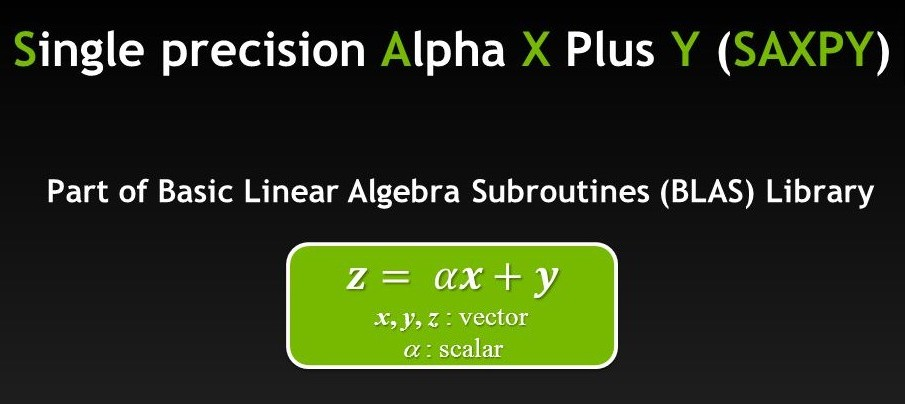

CuPy uses memory pool for memory allocations by default. The memory pool significantly improves the performance by mitigating the overhead of memory allocation and CPU/GPU synchronization.

There are two different memory pools in CuPy:

1. Device memory pool (GPU device memory), which is used for GPU memory allocations.
2. Pinned memory pool (non-swappable CPU memory), which is used during CPU-to-GPU data transfer.

In [ ]:
@cp.fuse()
def cp_saxpy_func(x, y, alpha):
    return x * alpha + y

def np_saxpy_func(x, y, alpha):
    return x * alpha + y

In [ ]:
sizes = np.logspace(1, 7)

In [ ]:
np_times = []
cp_times = []

for s in sizes:
    start = default_timer()
    x, y = cp.random.rand(int(s)), cp.random.rand(int(s))
    alpha = cp.random.rand()
    cp_saxpy_func(x.get(), y.get(), alpha.get()).sum()
    cp_times.append(default_timer() - start)

for s in sizes:
    start = default_timer()
    x, y = np.random.rand(int(s)), np.random.rand(int(s))
    alpha = np.random.rand()
    np_saxpy_func(x, y, alpha).sum()
    np_times.append(default_timer() - start)

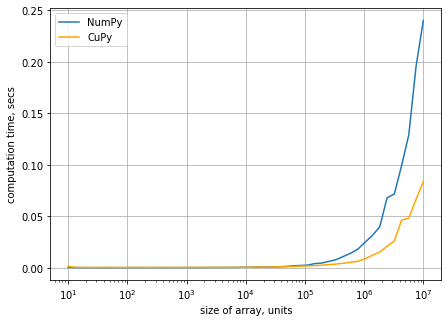

In [ ]:
plt.figure(figsize=(7, 5))

plt.semilogx(sizes, np_times, label='NumPy')

plt.semilogx(sizes, cp_times, color='orange', label='CuPy')

plt.xlabel('size of array, units')
plt.ylabel('computation time, secs')
plt.legend()
plt.grid()
plt.show()

## CuPy computation make sense.

## Task 11. CuPy-based Bifurcation map

By using <u><i><strong>CuPy</strong></i></u>, reimplement bifurcation map (Task 1).

In [9]:
NUM_OF_STEPS = 100000
# INITIAL_STATE = 0.1
M = 1000
N = 10000

In [10]:
cp_r_list = cp.linspace(0, 1, M)

In [15]:
@cp.fuse()
def cp_get_next_step(r, x):
    return r * x * (1. - x)

@cp.fuse()
def cp_get_bif_map(num_of_iters):
    # times = []
    data = cp.empty((M, M))

    start = default_timer()
    x = cp.repeat(cp.random.rand(), NUM_OF_STEPS)
    for index, r in enumerate(tqdm(cp_r_list)):
        for i in range(1, x.shape[0]):
            x[i] = cp_get_next_step(r, x[i-1])
        
        data[index] = x[index + N: index + N + M]
          
        # times.append()
        
        if num_of_iters < index:
          break

    return data, default_timer() - start

In [16]:
np_r_list = np.linspace(0, 1, M)

In [17]:
def np_get_next_step(r, x):
    return r * x * (1. - x)

def np_get_bif_map(num_of_iters):
    # times = []
    data = np.empty((M, M))

    start = default_timer()
    x = np.repeat(np.random.rand(), NUM_OF_STEPS)
    for index, r in enumerate(tqdm(np_r_list)):
        for i in range(1, x.shape[0]):
            x[i] = np_get_next_step(r, x[i-1])
        
        data[index] = x[index + N: index + N + M]

        # times.append()
        
        if num_of_iters < index:
          break
    return data, default_timer() - start

In [21]:
np_times = []
cp_times = []

for its in np.logspace(1, 2, 10):
    _, time = cp_get_bif_map(its)
    cp_times.append(time)

for its in np.logspace(1, 2, 10):
    _, time = np_get_bif_map(its)
    np_times.append(time)

 10%|█         | 101/1000 [00:07<01:03, 14.06it/s]


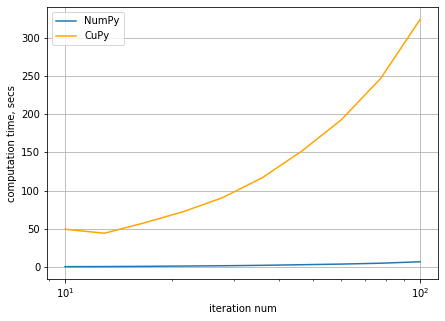

In [23]:
plt.figure(figsize=(7, 5))

plt.semilogx(np.logspace(1, 2, 10), np_times, label='NumPy')

plt.semilogx(np.logspace(1, 2, 10), cp_times, color='orange', label='CuPy')

plt.xlabel('iteration num')
plt.ylabel('computation time, secs')
plt.legend()
plt.grid()
plt.show()

## Okay, this time NumPy wons, but i think this is due to bad Colab GPU's permormance.

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:6: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  
100%|██████████| 100/100 [08:03<00:00,  4.83s/it]


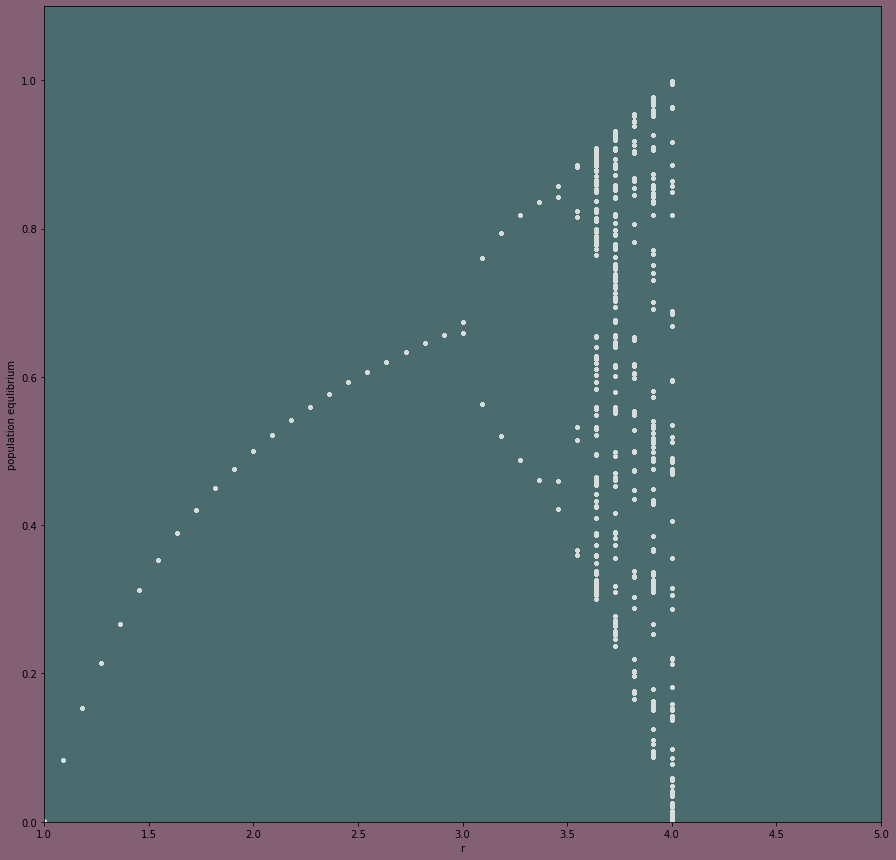

In [ ]:
# plt.figure(figsize=(15, 15))

# plt.gcf().set_facecolor('#846075')

# plt.axis([min(r_list), 5, 0, cp.amax(data) + 0.1])
# plt.axes().set_facecolor('#4A6C6F')

# plt.xlabel('r')
# plt.ylabel('population equlibrium')

# t = [(r * cp.ones(data.shape[0])).get() for r in r_list]

# for i in tqdm(range(M)):
#     plt.plot(t[:i], data[:i].get(), '.', color='#D7DEDC')
#     filename = 'image_' + '{0:08}.png'.format(i)
#     plt.savefig(filename, dpi=200)  

In [ ]:
fp_in = 'image_*.png'
fp_out = 'bif_map.gif'

In [ ]:
# img, *imgs = [Image.open(f) for f in sorted(glob.glob(fp_in))]
# img.save(fp=fp_out, format='GIF', append_images=imgs, save_all=True, duration=100, loop=0)

# for file_path in sorted(glob.glob(fp_in)):
#     try:
#         os.remove(file_path)
#     except:
#         print('Error while deleting file : ', file_path)
# print('Animation saved in file', fp_out)

Animation saved in file bif_map.gif


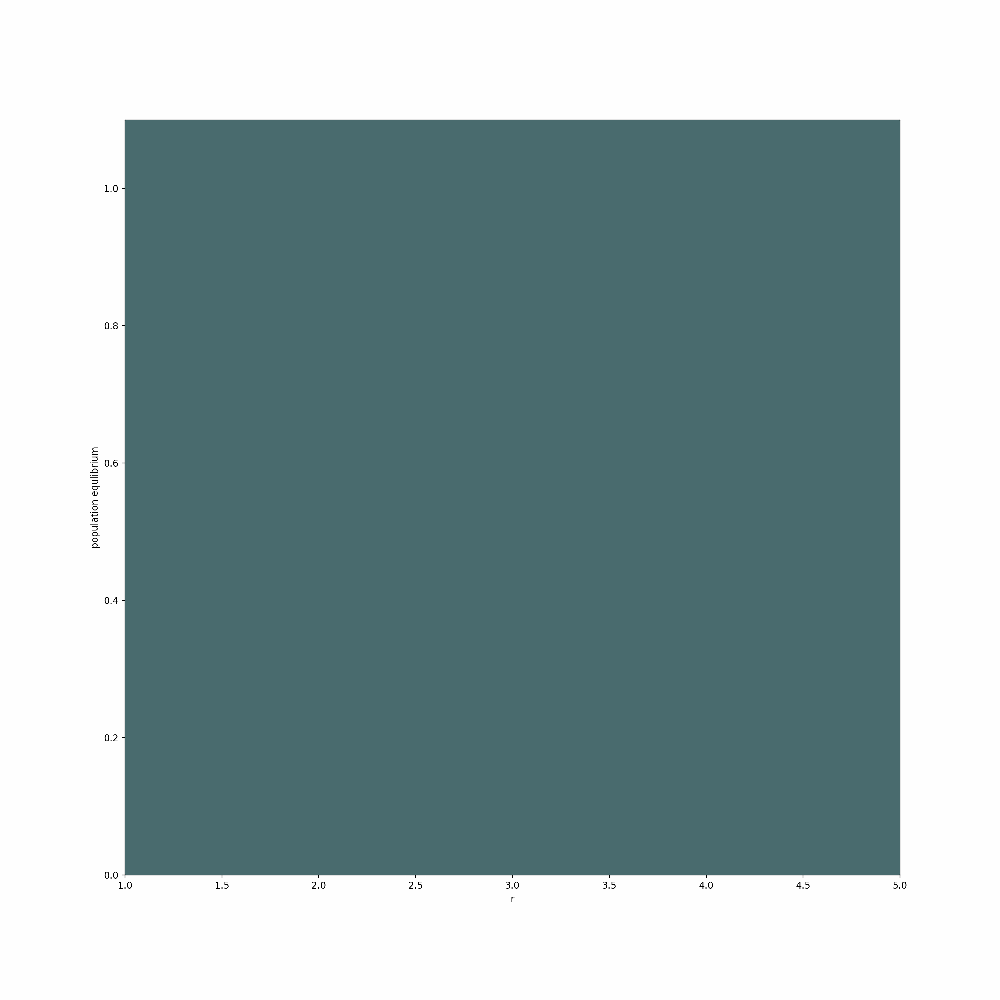

In [ ]:
Img(open(fp_out,'rb').read())

## Task 12. Histogram


<u>By using <i><strong>CuPy</strong></i>:</u>
* Implement the suggested function:
$$
 f(x) = (z^2(x) + z^3(x) - 200 \,\, z^4(x) )\,\,\sin(\,\,100000\,\,(x + 0.5)\,\,),
 \\
 \text{where    }\:\:\: z(x) = \sin(3\,\,x)-0.5
$$
* Plot function on the $x$ interval $[0,\,\, 1]$. Number of points = 10000000.
* Get minimal and maximal values of function on the interval $[0,\,\, 1]$: $f_{min}$ and $f_{max}$.
* Divide $y=f(x), \: (x \in [0,\,\, 1]) \:$ interval $[f_{min}, f_{max}]$ into $10$ $y=f(x)$ subintervals of length $\delta$ equal to $0.1 \,\, (f_{max}-f_{min})$: $[f_{min},\,\, f_{min} + \delta],\,\, [f_{min}+ \delta,\,\, f_{min} + 2 \,\, \delta],\,\, \dots,\,\, [f_{max}- \delta,\,\, f_{max}]$.
* Compute number of $y=f(x), \: (x \in [0,\,\, 1]) \:$ values in each subinterval. Use $\operatorname{cp.sum(\dots)}$
* Plot histogram. <strong>[Hint: how to represent the histogram](https://cdn.datamentor.io/wp-content/uploads/2017/11/r-histogram.png)</strong>

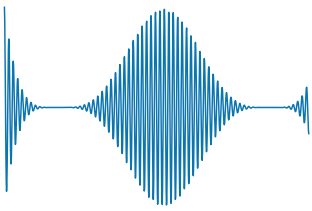

In [ ]:
@cp.fuse()
def z_func(x):
    return cp.sin(3 * x) - 0.5

@cp.fuse()
def f_func(x):
    z = z_func(x)
    z_squared = cp.power(z, 2)

    return z_squared * (1. + z - 200 * z_squared) * cp.sin(1000000 * (x + 0.5))

In [ ]:
x = cp.linspace(0., 1., 10000000)

In [ ]:
f_cp_vals = f_func(x)

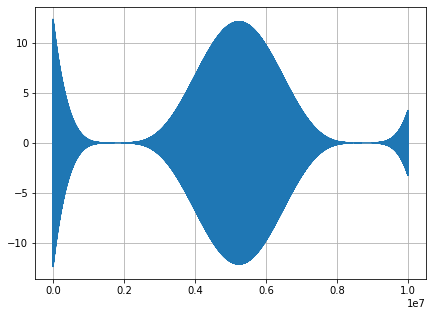

In [ ]:
plt.figure(figsize=(7, 5))

plt.plot(f_cp_vals.get())

plt.grid()
plt.show()

In [ ]:
f_min, f_max = f_cp_vals.min().get(), f_cp_vals.max().get() 

In [ ]:
print('f_min = {:.3f}'.format(f_min))
print('f_max = {:.3f}'.format(f_max))

f_min = -12.373
f_max = 12.369


In [ ]:
sigma = 0.1 * (f_max - f_min)

In [ ]:
y = cp.arange(f_min, f_max + sigma, sigma)``
y

array([-1.23730514e+01, -9.89883147e+00, -7.42461150e+00, -4.95039154e+00,
       -2.47617157e+00, -1.95160797e-03,  2.47226836e+00,  4.94648832e+00,
        7.42070829e+00,  9.89492825e+00,  1.23691482e+01])

In [ ]:
bins = []

for i in tqdm(range(1, y.shape[0])):
    a, b = y[i-1], y[i]

    is_inside = ((a < f_cp_vals) & (f_cp_vals < b))
    
    bin = cp.sum(is_inside).get()
    bins.append(bin)

100%|██████████| 10/10 [00:00<00:00, 14.67it/s]


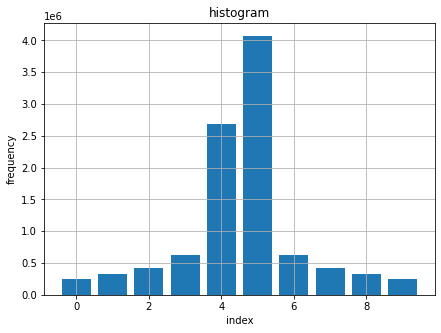

In [ ]:
plt.figure(figsize=(7, 5))

plt.bar(range(len(bins)), bins)

plt.title('histogram')
plt.xlabel('index')
plt.ylabel('frequency')

plt.grid()
plt.show()

In [41]:
@cp.fuse()
def z_func(x):
    return cp.sin(3 * x) - 0.5

@cp.fuse()
def f_func(x):
    z = z_func(x)
    z_squared = cp.power(z, 2)

    return z_squared * (1. + z - 200 * z_squared) * cp.sin(1000000 * (x + 0.5))

def cp_get_bins():
  x = cp.linspace(0., 1., 10000000)

  f_cp_vals = f_func(x)
  
  f_min, f_max = f_cp_vals.min().get(), f_cp_vals.max().get() 
  sigma = 0.1 * (f_max - f_min)

  y = cp.arange(f_min, f_max + sigma, sigma)
  
  # bins = []

  start = default_timer()
  for i in range(1, y.shape[0]):
    a, b = y[i-1], y[i]

    is_inside = ((a < f_cp_vals) & (f_cp_vals < b))
    
    bin = cp.sum(is_inside).get()
    # bins.append(bin)
  
  return default_timer() - start

In [49]:
def z_func(x):
    return np.sin(3 * x) - 0.5

def f_func(x):
    z = z_func(x)
    z_squared = np.power(z, 2)

    return z_squared * (1. + z - 200 * z_squared) * np.sin(1000000 * (x + 0.5))

def np_get_bins():
  x = np.linspace(0., 1., 10000000)

  f_cp_vals = f_func(x)
  
  f_min, f_max = f_cp_vals.min(), f_cp_vals.max()
  sigma = 0.1 * (f_max - f_min)

  y = np.arange(f_min, f_max + sigma, sigma)
  
  # bins = []

  start = default_timer()
  for i in range(1, y.shape[0]):
    a, b = y[i-1], y[i]

    is_inside = ((a < f_cp_vals) & (f_cp_vals < b))
    
    bin = np.sum(is_inside)
    # bins.append(bin)

  return default_timer() - start

In [52]:
avg = 0.

for _ in range(10):
  avg += cp_get_bins()

avg /= 10

print(f'CuPy took: {avg:.2f}')

CuPy took: 0.12


In [54]:
avg = 0.

for _ in range(10):
  avg += np_get_bins()

avg /= 10

print(f'NumPy took: {avg:.2f}')

NumPy took: 0.33


## Task 13. Image blur


<u>By using <i><strong>CuPy</strong></i>:</u>
* Implement the gpu version of the image blur algorithm. What you need to do is calculate convolution some image and some blur filter on every pixel. You should compute convolutions in parallel for every pixel using gpu cores.
* Take any 100x100 image and 

<strong >Example of a blurred image:</strong>

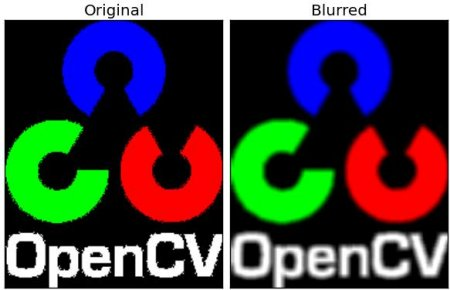

In [24]:
img_name = 'cat.jpg'

In [25]:
np_img = plt.imread(img_name)
cp_img = cp.asarray(plt.imread(img_name))

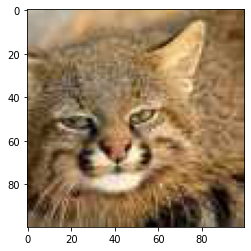

In [26]:
plt.imshow(np_img)

plt.show()

# I choose a simple average kernel:

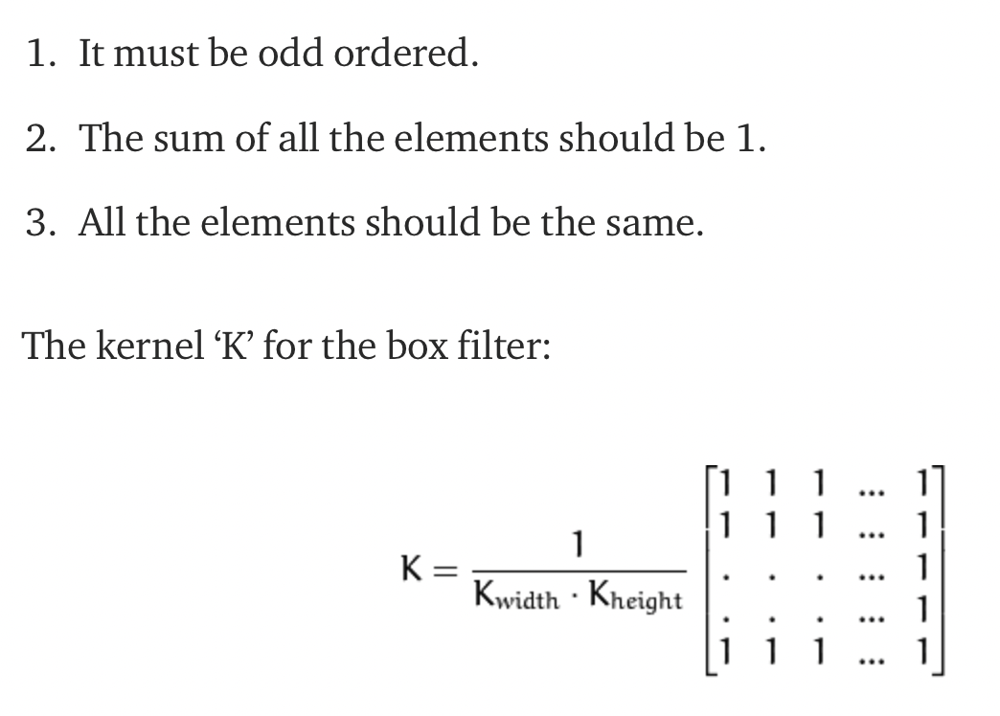

In [27]:
def get_np_kernel(size):
    if size % 2 == 0:
        raise ValueError

    return 1 / (size**2) * np.ones((size, size))

def get_cp_kernel(size):
    if size % 2 == 0:
        raise ValueError

    return 1 / (size**2) * cp.ones((size, size))

In [28]:
np_kernel = get_np_kernel(3)
cp_kernel = get_cp_kernel(3)

In [29]:
from scipy.signal import convolve2d as np_conv

In [30]:
%%time
np_blur_img = np.dstack([np_conv(np_img[:, :, i], np_kernel) for i in range(np_img.shape[-1])]).astype(np.uint8)

CPU times: user 2.02 ms, sys: 2 ms, total: 4.02 ms
Wall time: 4.24 ms


In [31]:
from cupyx.scipy.signal import convolve2d as cp_conv

In [32]:
%%time
cp_blur_img = cp.dstack([cp_conv(cp_img[:, :, i], cp_kernel) for i in range(cp_img.shape[-1])])

CPU times: user 1.56 s, sys: 20 ms, total: 1.58 s
Wall time: 1.57 s


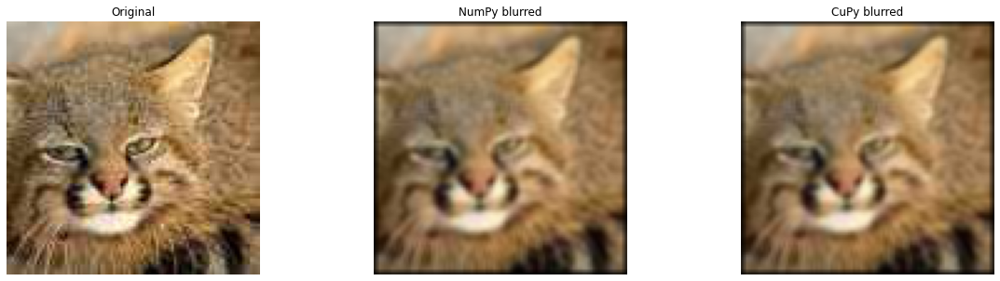

In [33]:
fig, ax = plt.subplots(figsize=(20, 5), ncols=3)

ax[0].imshow(np_img)
ax[0].set_title('Original')
ax[0].axis('off')

ax[1].imshow(np_blur_img)
ax[1].set_title('NumPy blurred')
ax[1].axis('off')

ax[2].imshow(cp_blur_img.get())
ax[2].set_title('CuPy blurred')
ax[2].axis('off')

plt.show()

## From the first look, NumPy and CuPy gave same blurring quality

# Perfomance comparison

In [36]:
%timeit -n 10 np.dstack([np_conv(np_img[:, :, i], np_kernel) for i in range(np_img.shape[-1])]).astype(np.uint8)

10 loops, best of 5: 1.32 ms per loop


In [37]:
%timeit -n 10 cp.dstack([cp_conv(cp_img[:, :, i], cp_kernel) for i in range(cp_img.shape[-1])])

10 loops, best of 5: 249 µs per loop


## As we can see, usage of CuPy makes sense again.